# IBM CAPSTONE PROJECT  : The Battle of Neighborhoods 
### Seafood restaurant in Paris
#### Mohammed Bouayoun

## 1. Introduction  

Paris is the capital and most populous city of France, with a population of 2,148,271 residents in an area of 105 square kilometers (41 square miles). Since the 17th century, Paris has been one of Europe's major centers of finance, diplomacy, commerce, fashion, science and the arts. The City of Paris is the center and seat of government of the Île-de-France, or Paris Region, which has an estimated official 2020 population of 12,278,210, or about 18 percent of the population of France.

The Paris Region had a GDP of €709 billion ($808 billion) in 2017.According to the Economist Intelligence Unit Worldwide Cost of Living Survey in 2018, Paris was the second most expensive city in the world, after Singapore, and ahead of Zürich, Hong Kong, Oslo and Geneva.[4] Another source ranked Paris as most expensive, on a par with Singapore and Hong Kong, in 2018.


## IRIS Data

In order to prepare for the dissemination of the 1999 population census, INSEE had developed a division of the territory into homogenously sized grids called IRIS2000. This acronym stood for "Ilots Regrouped for Statistical Information" and referred to the target size of 2,000 inhabitants per elementary grid cell.  

Since then, IRIS has been the basic building block for the dissemination of infra-municipal data. It must comply with geographical and demographic criteria and have unambiguously identifiable contours that are stable over time.  

Municipalities with at least 10,000 inhabitants and a high proportion of municipalities with 5,000 to 10,000 inhabitants are divided into IRIS. This division constitutes a partition of their territory. France has approximately 16,100 IRIS, 650 of which are in the overseas departments.  

By extension, in order to cover the whole territory, each of the communes not divided into IRIS is considered as one IRIS.  

This dataset contains statistical data from INSEE to IRIS on the territory of the Greater Paris Metropolitan Area in the field of demography with : 
- Population growth rate 
- Population density per hectare
- Youth Index  
- Managers Senior intel. prof./Laboureratorial staff
- Share of foreign population 
- Share of the immigrant population

There are three types of IRIS:  

    Housing IRIS: their population is generally between 1,800 and 5,000 inhabitants. They are homogeneous in terms of habitat type and their boundaries are based on the major cuts in the urban fabric (main roads, railways, waterways, etc.).  
    Activity IRISs: they have more than 1,000 employees and have at least twice as many salaried jobs as the resident population.
    Miscellaneous IRIS: these are large specific areas with few inhabitants and a large surface area (leisure parks, port areas, forests, etc.).  
    
We're not going to use all these variables, we're going to do a hard clean up and take only the variables we're interested in. The density of the population, foreigners and immigrates will help us find a location at our restaurant in addition to the Foursquare API to find our conquerors and fishmongers.  

#### Attribute Definition

- c_ir : IRIS Code
- c_typeir : Type of IRIS: Habitat (H), Activity (A), Miscellaneous (D), Other (Z)
- c12_pop1_1 : Number of persons aged 15 years or over Farmers
- c12_pop1_2 : Number of persons aged 15 years or more Craftsmen, Traders, Entrepreneurs
- c12_pop1_3 : Number of persons aged 15 years and over Executives and Senior Professionals
- c12_pop1_4 : Number of persons aged 15 or over Intermediate occupations
- c12_pop1_5 : Number of active employees
- c12_pop1_6 : Number of persons 15 years or older Workers
- c12_pop15p : Number of employed persons 15 years of age or older
- com : Department code followed by the commune or municipal district number for Paris Lyon and Marseille
- denspop12 : population density
- dep : Department Code
- geometry : IRIS geometry
- iris : Department code followed by the commune or municipal district number followed by the IRIS number
- iris_num : IRIS number
- l_ir : IRIS label
- libcom : Name of the municipality or municipal district for Paris Lyon and Marseille
- libris : "Wording of the IRIS within the municipality or municipal district for Paris Lyon and Marseille
- n_qu : Neighbourhood number
- n_sq_ir : Iris number
- nom_ept : Name of the city
- objectid : Object Id
- p12_f0014 : female population between 0 and 14 years old
- p12_f1529 : female population between 15 and 29 years old
- p12_f3044 : female population between 30 and 40 years old
- p12_f4559 : female population between 45 and 59 years old
- p12_f6074 : female population between 60 and 73 years old
- p12_f75p : population women over 75 years old
- p12_h0014 : male population between 0 and 14 years old
- p12_h1529 : male population between 15 and 29 years old
- p12_h3044 : male population between 30 and 40 years old
- p12_h4559 : male population between 45 and 59 years old
- p12_h6074 : male population between 60 and 73 years old
- p12_h75p : male population over 75 years old
- p12_pop : total population in 2012
- p12_pop_et : foreign population
- p12_pop_im : immigrant population
- tx12_pop_e : Foreign population rate
- tx12_pop_i : Foreign population rate of immigrants
- typ_iris : Type of IRIS
- uu2010 : Department code or "00" for urban units extending over several departments or even across the border followed by a code on a position indicating the population size and then a serial number within the size








## Methodology

* Download the IRIS dataset  

* Clean the IRIS dataset

* Analyze the IRIS dataset

* Visualize the IRIS dataset

* Utilize the Foursquare API to explore the neighborhoods and seafood restaurant in Paris

* Merge cleaned IRIS dataset with seafoods restaurant

* Segment neighborhoods using k-means clustering to locate seafood restaurant

* Overlay clusters with restaurants, fish shops and activity people

* Take places that are far from restaurants and near to fish shops according to the density of the people

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
#pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests

import folium # map rendering library

from sklearn.cluster import KMeans
from sklearn.metrics import  silhouette_score

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

import geopandas as gpd
import matplotlib.pyplot as plt
from pandas.io.json import json_normalize

from PIL import Image               # to load images
from IPython.display import display # to display images
from shapely.geometry import Polygon
from shapely.geometry import Point

In [3]:
#pd.set_option('display.width', 200)
pd.set_option('display.max_columns', None)

### IRIS Data

The dataset can be found on the website of **public.opendatasoft.com**.   

In [4]:
url1 = "https://public.opendatasoft.com/explore/dataset/iris-demographie/download/?format=geojson&refine.nom_ept=Paris&refine.dep=75&timezone=Europe/Berlin&lang=fr"
iris_paris = gpd.read_file(url1)

In [5]:
iris_paris.head()

,txan0712_p,p12_f4559,objectid,typ_iris,p12_f0014,libcom,m2_pop,c_cainsee,m2_ip,shape_leng,p12_h1529,p12_pop,p12_f1529,p12_f6074,l_ir,ept,n_qu,p12_pop_et,p12_pop_im,shape_ha,c_typeir,c12_pop1_6,libiris,c12_pop1_4,c12_pop1_5,p12_h6074,c12_pop1_1,c12_pop1_2,c12_pop1_3,p12_h75p,p12_f3044,iris_num,p12_pop001,uu2010,lab_iris,c_ir,modif_iris,p12_h3044,nom_ept,indjeun201,iris,p12_h0014,shape_area,denspop12,dep,p12_f75p,cs3_cs56,n_sq_ir,m2_emp,p07_pop,tx12_pop_e,tx12_pop_i,com,c12_pop15p,p12_h4559,p12_pop60p,geometry
0,4.768068,104.800508,7,A,95.286204,Paris 12e Arrondissement,61499.708471,75112,82607.116554,1621.266961,140.588055,1202.300156,168.779696,58.648102,Quinze Vingts 12,T1,48,258.511889,286.173742,10.989434,A,602.062141,Quinze Vingts 12,155.486808,116.027337,61.486003,17.924031,178.780794,133.843171,14.706983,122.988837,751124812,292.713528,00851,3,751124812,00,160.722951,Paris,1.681145,751124812,120.986149,109880.879603,109.405100,75,39.274478,0.658458,750004731,81427.120030,952.507090,21.501444,23.802188,75112,0.000000,114.032192,174.115566,"POLYGON ((2.37119 48.84553, 2.37138 48.84532, ..."
1,-1.741516,149.228164,100,H,93.673510,Paris 2e Arrondissement,43597.653452,75102,49799.961137,1209.823389,334.865035,2093.393451,408.817301,57.883981,Bonne Nouvelle 4,T1,8,416.828953,501.054088,7.007072,H,1496.105007,Bonne Nouvelle 4,250.405822,112.657015,88.343219,68.073782,705.514319,359.454070,14.959356,289.207841,751020804,245.032649,00851,1,751020804,00,347.856871,Paris,1.178538,751020804,81.352073,70065.324053,298.754362,75,46.725774,1.943229,750004346,49386.535551,2285.601834,19.911639,23.935017,75102,0.000000,180.480326,207.912330,"POLYGON ((2.35263 48.86969, 2.35236 48.86922, ..."
2,1.992905,158.010325,106,H,57.483646,Paris 3e Arrondissement,33647.581644,75103,70551.719678,1667.841821,177.666202,1758.298699,237.956781,113.800779,Arts et Metiers 5,T1,9,349.707547,433.197404,10.767693,H,1093.870971,Arts et Metiers 5,231.385076,88.712835,107.633858,50.572334,449.754158,270.656007,42.442989,204.811621,751030905,270.584243,00851,2,751030905,00,295.105987,Paris,0.827397,751030905,110.988366,107668.318527,163.293906,75,63.153017,1.405052,750004351,63085.923717,1593.099290,19.888973,24.637304,75103,2.790561,189.245130,327.030642,"POLYGON ((2.35559 48.86902, 2.35552 48.86888, ..."
3,NaN,1.561952,201,A,0.000000,Paris 7e Arrondissement,4.779362,75107,24012.230853,856.303768,0.000000,7.809760,0.000000,0.000000,Saint-Thomas d'Aquin 8,T1,25,0.000000,0.000000,3.133818,A,4.685856,Saint-Thomas d'Aquin 8,0.000000,0.000000,0.000000,0.000000,4.685856,0.000000,0.000000,0.000000,751072508,3.123904,00851,3,751072508,00,0.000000,Paris,NaN,751072508,3.123904,31335.277939,2.492091,75,0.000000,NaN,750004498,24012.230853,0.000000,0.000000,0.000000,75107,0.000000,3.123904,0.000000,"POLYGON ((2.32939 48.85953, 2.32925 48.85947, ..."
4,NaN,NaN,324,D,NaN,Paris 10e Arrondissement,8.438256,75110,13224.359747,1445.817043,NaN,NaN,NaN,NaN,Canal St Martin,T1,39,NaN,NaN,3.139254,D,0.000000,Canal St-Martin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,751103988,NaN,00851,3,751103988,00,NaN,Paris,NaN,751103988,NaN,31390.310215,0.000000,75,NaN,NaN,750004270,326.993538,0.000000,NaN,NaN,75110,NaN,NaN,0.000000,"POLYGON ((2.36357 48.87405, 2.36366 48.87391, ..."


Dimension of iris_paris dataset

In [6]:
iris_paris.shape

(992, 57)

In [7]:
iris_paris.columns

Index(['txan0712_p', 'p12_f4559', 'objectid', 'typ_iris', 'p12_f0014',
       'libcom', 'm2_pop', 'c_cainsee', 'm2_ip', 'shape_leng', 'p12_h1529',
       'p12_pop', 'p12_f1529', 'p12_f6074', 'l_ir', 'ept', 'n_qu',
       'p12_pop_et', 'p12_pop_im', 'shape_ha', 'c_typeir', 'c12_pop1_6',
       'libiris', 'c12_pop1_4', 'c12_pop1_5', 'p12_h6074', 'c12_pop1_1',
       'c12_pop1_2', 'c12_pop1_3', 'p12_h75p', 'p12_f3044', 'iris_num',
       'p12_pop001', 'uu2010', 'lab_iris', 'c_ir', 'modif_iris', 'p12_h3044',
       'nom_ept', 'indjeun201', 'iris', 'p12_h0014', 'shape_area', 'denspop12',
       'dep', 'p12_f75p', 'cs3_cs56', 'n_sq_ir', 'm2_emp', 'p07_pop',
       'tx12_pop_e', 'tx12_pop_i', 'com', 'c12_pop15p', 'p12_h4559',
       'p12_pop60p', 'geometry'],
      dtype='object')

Create a new dataset CLEAN_PARSIS with some columns

In [8]:
clean_paris = iris_paris[['objectid','typ_iris','libcom','l_ir','n_qu','p12_pop_et','p12_pop_im','shape_ha','libiris','iris','denspop12','tx12_pop_e','tx12_pop_i','c12_pop1_1','c12_pop1_2','c12_pop1_3','c12_pop1_4','c12_pop1_5','c12_pop1_6','c12_pop15p','com','geometry']]

Columns of a new clean dataset

In [9]:
clean_paris.columns

Index(['objectid', 'typ_iris', 'libcom', 'l_ir', 'n_qu', 'p12_pop_et',
       'p12_pop_im', 'shape_ha', 'libiris', 'iris', 'denspop12', 'tx12_pop_e',
       'tx12_pop_i', 'c12_pop1_1', 'c12_pop1_2', 'c12_pop1_3', 'c12_pop1_4',
       'c12_pop1_5', 'c12_pop1_6', 'c12_pop15p', 'com', 'geometry'],
      dtype='object')

In [10]:
clean_paris.head()

,objectid,typ_iris,libcom,l_ir,n_qu,p12_pop_et,p12_pop_im,shape_ha,libiris,iris,denspop12,tx12_pop_e,tx12_pop_i,c12_pop1_1,c12_pop1_2,c12_pop1_3,c12_pop1_4,c12_pop1_5,c12_pop1_6,c12_pop15p,com,geometry
0,7,A,Paris 12e Arrondissement,Quinze Vingts 12,48,258.511889,286.173742,10.989434,Quinze Vingts 12,751124812,109.405100,21.501444,23.802188,17.924031,178.780794,133.843171,155.486808,116.027337,602.062141,0.000000,75112,"POLYGON ((2.37119 48.84553, 2.37138 48.84532, ..."
1,100,H,Paris 2e Arrondissement,Bonne Nouvelle 4,8,416.828953,501.054088,7.007072,Bonne Nouvelle 4,751020804,298.754362,19.911639,23.935017,68.073782,705.514319,359.454070,250.405822,112.657015,1496.105007,0.000000,75102,"POLYGON ((2.35263 48.86969, 2.35236 48.86922, ..."
2,106,H,Paris 3e Arrondissement,Arts et Metiers 5,9,349.707547,433.197404,10.767693,Arts et Metiers 5,751030905,163.293906,19.888973,24.637304,50.572334,449.754158,270.656007,231.385076,88.712835,1093.870971,2.790561,75103,"POLYGON ((2.35559 48.86902, 2.35552 48.86888, ..."
3,201,A,Paris 7e Arrondissement,Saint-Thomas d'Aquin 8,25,0.000000,0.000000,3.133818,Saint-Thomas d'Aquin 8,751072508,2.492091,0.000000,0.000000,0.000000,4.685856,0.000000,0.000000,0.000000,4.685856,0.000000,75107,"POLYGON ((2.32939 48.85953, 2.32925 48.85947, ..."
4,324,D,Paris 10e Arrondissement,Canal St Martin,39,NaN,NaN,3.139254,Canal St-Martin,751103988,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,75110,"POLYGON ((2.36357 48.87405, 2.36366 48.87391, ..."


#### Let's see cutting Paris into IRIS

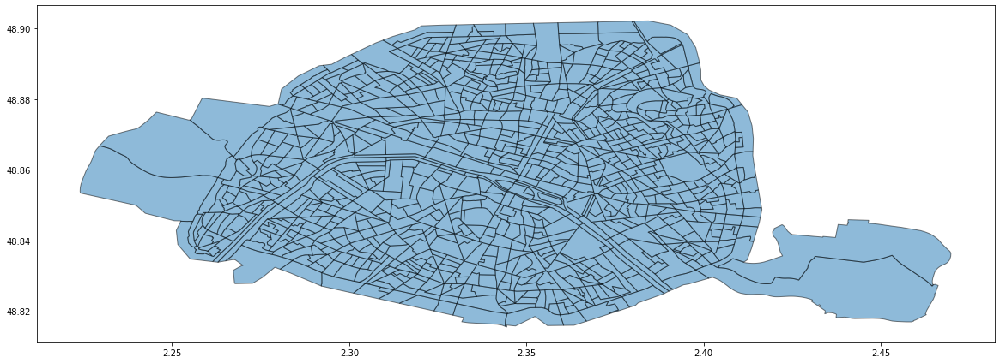

In [11]:
clean_paris.plot( figsize=(20,10),alpha=0.5, edgecolor='k')

#### We remove leisure parks, port areas, forests, etc.
There are 3 types of IRIS :  
type : A Activity  
type : H Habitat  
type : D Miscellaneous  


In [12]:
clean_paris = clean_paris[iris_paris['typ_iris'] != 'D' ]

In [13]:
clean_paris.shape

(949, 22)

#### We can see here Paris without leisure parks, port areas, forests, etc.

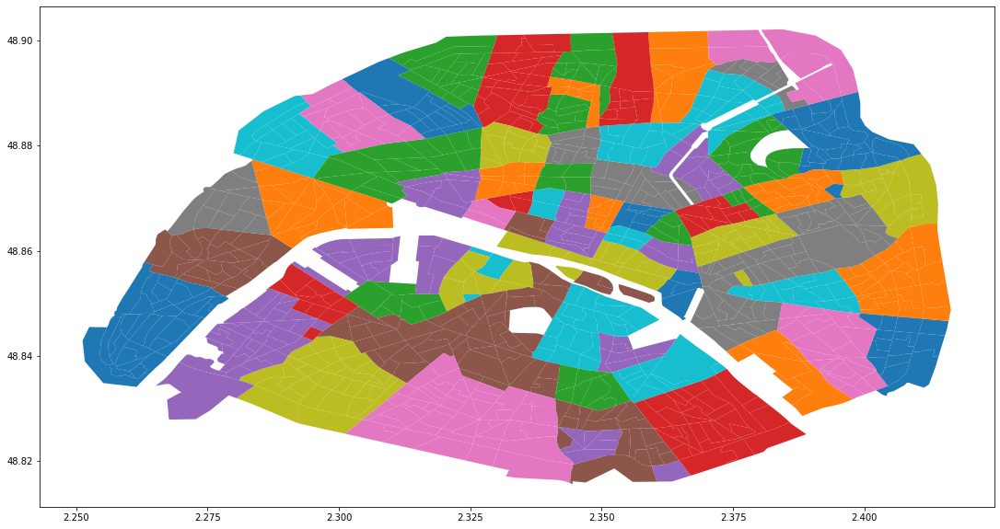

In [14]:
clean_paris.plot(column='l_ir', figsize=(20,10))

In [15]:
clean_paris['libcom'] = clean_paris['libcom'].str.replace(' Arrondissement','')

Rename column l_ir with Neighborhood

In [16]:
clean_paris.rename(columns ={'l_ir':'Neighborhood'},inplace = True)

Coordiante of Paris with geocoder

In [17]:
address = 'PARIS ,PAR'

geolocator = Nominatim(user_agent="pr_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Paris are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Paris are 48.8418339, 2.3497835.


### Population density with folium

In [18]:
m = folium.Map(location=[latitude, longitude], zoom_start=12)
m.choropleth(
 geo_data=clean_paris,
 name='choropleth',
 data=clean_paris,
 columns=['Neighborhood', 'denspop12'],
 key_on='feature.properties.Neighborhood',
 fill_color='YlOrRd',
 fill_opacity=0.8,
 line_opacity=0.2,
 legend_name='Density Population'
)
folium.LayerControl().add_to(m)
m

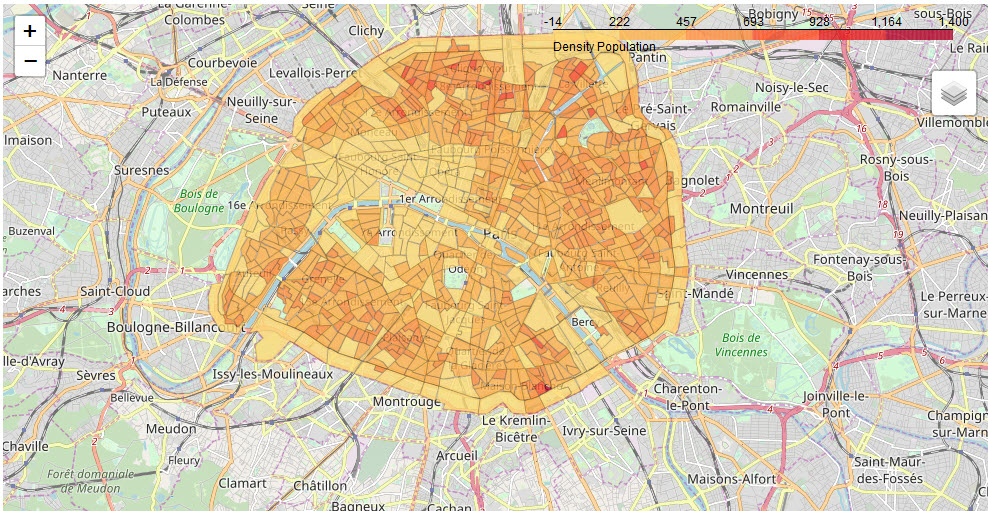

In [173]:
pil_im = Image.open('mb1.jpg')
display(pil_im)

### Population density whith geopandas

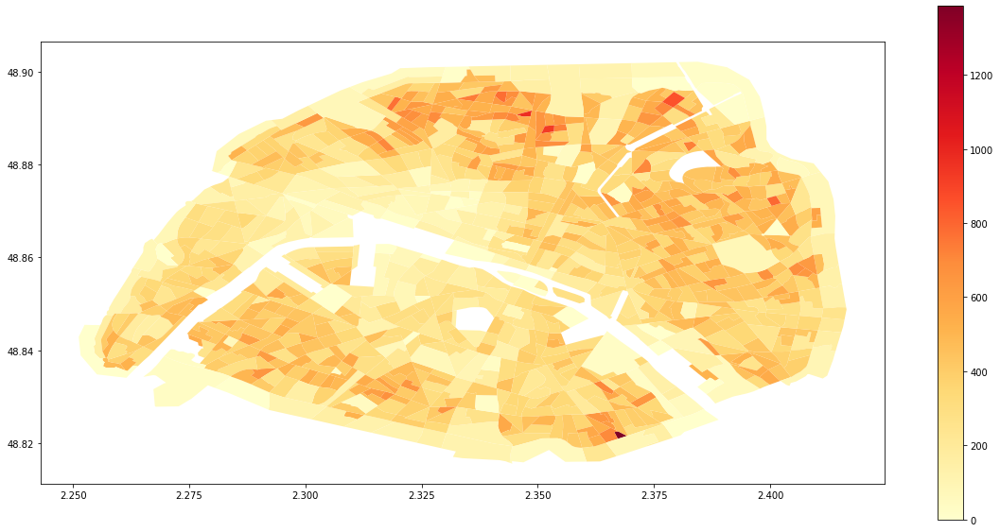

In [19]:
clean_paris.plot(column='denspop12', legend=True, figsize=(20,10),cmap='YlOrRd')

It is noticeable that there is a concentration of population around Paris.

#### Let's see statistiques of populations

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


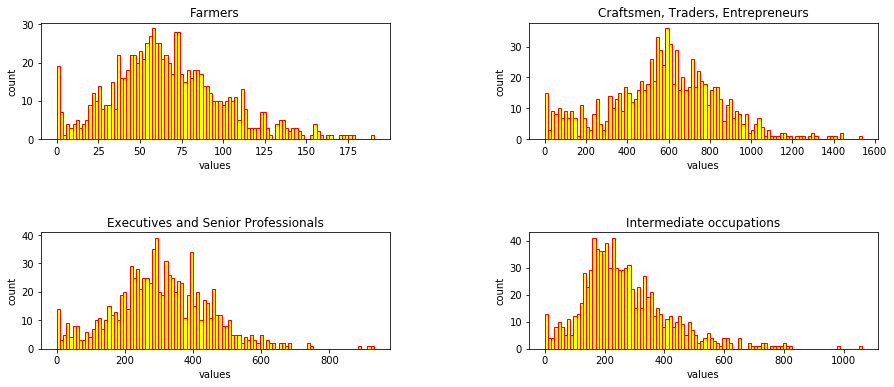

In [20]:
plt.figure(figsize=(15, 6))
plt.subplots_adjust(hspace=0.8, wspace=0.4)
plt.subplot(2,2,1)
plt.hist(clean_paris['c12_pop1_1'], bins = 100, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('values')
plt.ylabel('count')
plt.title('Farmers')

plt.subplot(2,2,2)
plt.hist(clean_paris['c12_pop1_2'], bins = 100, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('values')
plt.ylabel('count')
plt.title('Craftsmen, Traders, Entrepreneurs')


plt.subplot(2,2,3)
plt.hist(clean_paris['c12_pop1_3'], bins = 100, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('values')
plt.ylabel('count')
plt.title('Executives and Senior Professionals')

plt.subplot(2,2,4)
plt.hist(clean_paris['c12_pop1_4'], bins = 100, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('values')
plt.ylabel('count')
plt.title('Intermediate occupations')

plt.show()

#### Here some  statisques of  population 

In [21]:
clean_paris['denspop12'].describe()

count     949.000000
mean      354.439277
std       174.339516
min         0.000000
25%       245.387589
50%       369.250129
75%       467.391703
max      1385.698711
Name: denspop12, dtype: float64

The majority of the population of Paris are Crafstmen, Traders or Enrepreneurs.   
The histogram almost follows a normal distribution law flattened to the right.

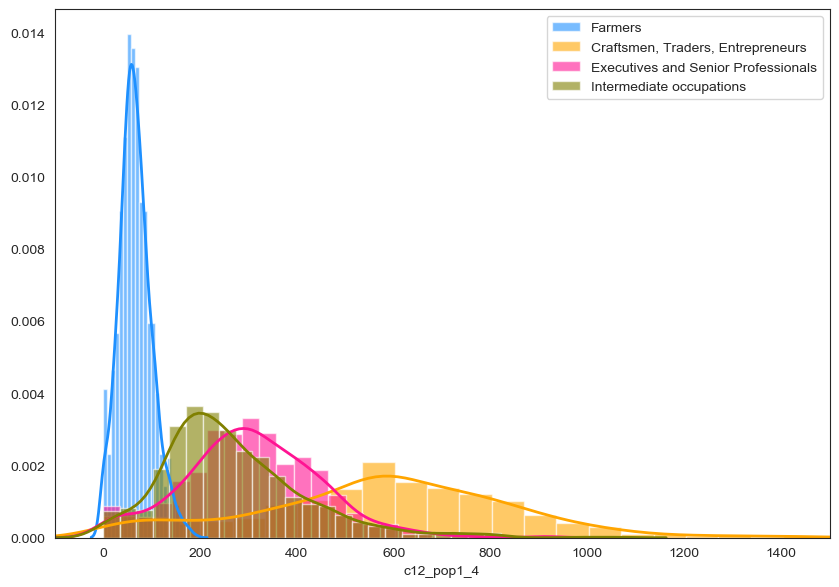

In [22]:
import seaborn as sns
sns.set_style("white")

kwargs = dict(hist_kws={'alpha':.6}, kde_kws={'linewidth':2})

plt.figure(figsize=(10,7), dpi= 100)
sns.distplot(clean_paris['c12_pop1_1'], color="dodgerblue", label="Farmers", **kwargs)
sns.distplot(clean_paris['c12_pop1_2'], color="orange", label="Craftsmen, Traders, Entrepreneurs", **kwargs)
sns.distplot(clean_paris['c12_pop1_3'], color="deeppink", label="Executives and Senior Professionals", **kwargs)
sns.distplot(clean_paris['c12_pop1_4'], color="olive", label="Intermediate occupations", **kwargs)

plt.xlim(-100,1500)
plt.legend();

Farmer density in Paris

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Text(0.5, 1, 'Farmers')

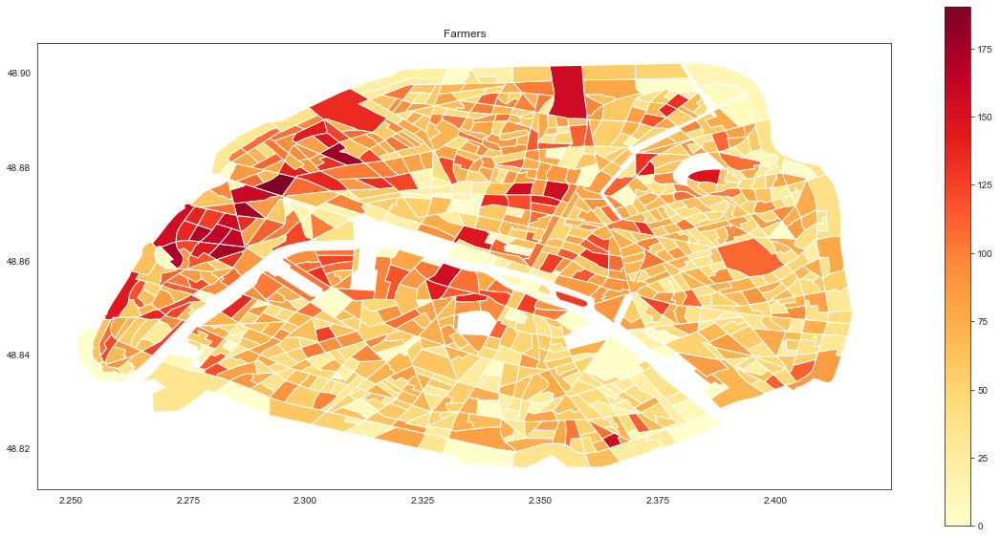

In [23]:
ax = clean_paris.plot(column = 'c12_pop1_1', legend=True,figsize=(20,10),cmap='YlOrRd')
ax.set_title("Farmers")

Craftsmen, Traders, Entrepreneurs density in Paris

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Text(0.5, 1, 'Craftsmen, Traders, Entrepreneurs')

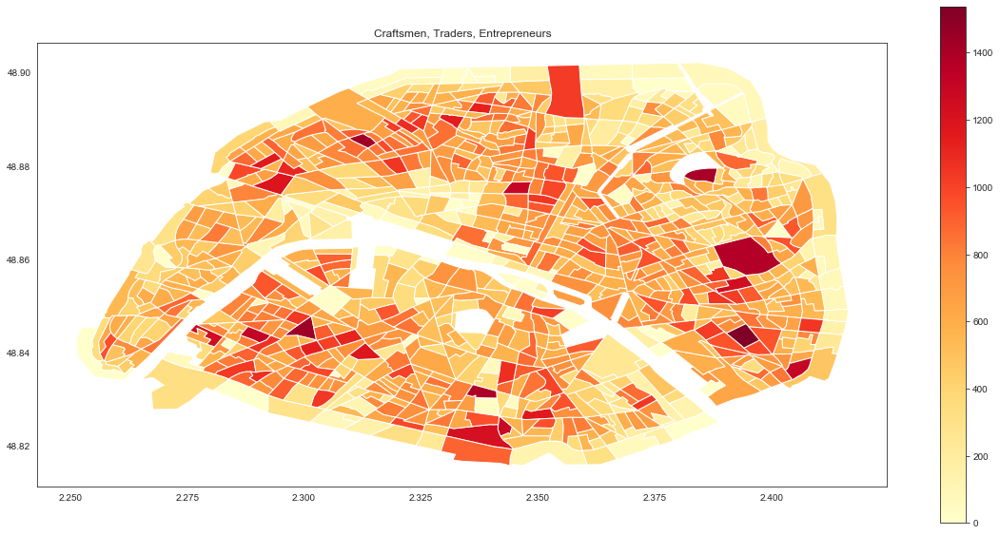

In [24]:
ax = clean_paris.plot(column = 'c12_pop1_2', legend=True,figsize=(20,10),cmap='YlOrRd')
ax.set_title("Craftsmen, Traders, Entrepreneurs")

Executives and Senior Professionals density in Paris

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Text(0.5, 1, 'Executives and Senior Professionals')

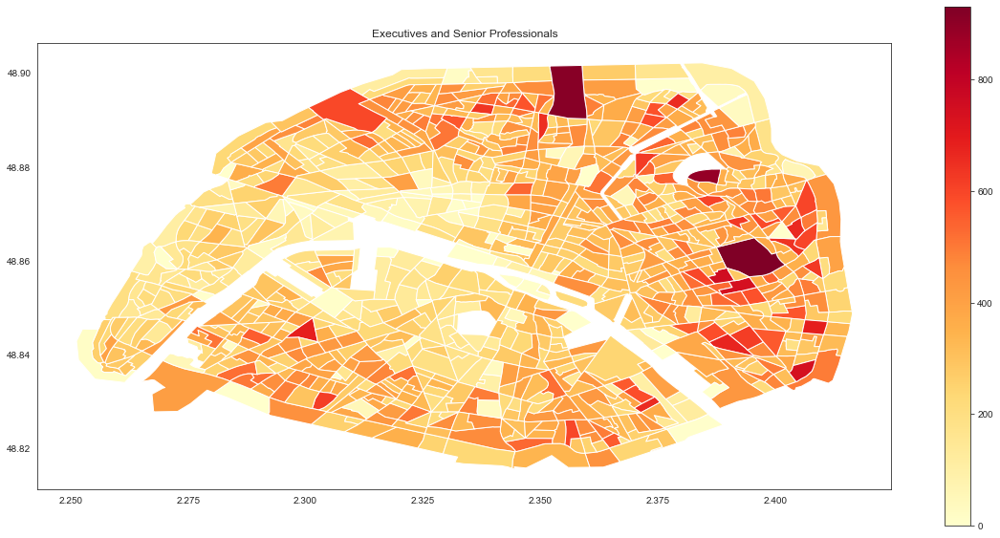

In [25]:
ax = clean_paris.plot(column = 'c12_pop1_3',legend=True,figsize=(20,10),cmap='YlOrRd')
ax.set_title("Executives and Senior Professionals")

Intermediate occupations density in Paris

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Text(0.5, 1, 'Intermediate occupations')

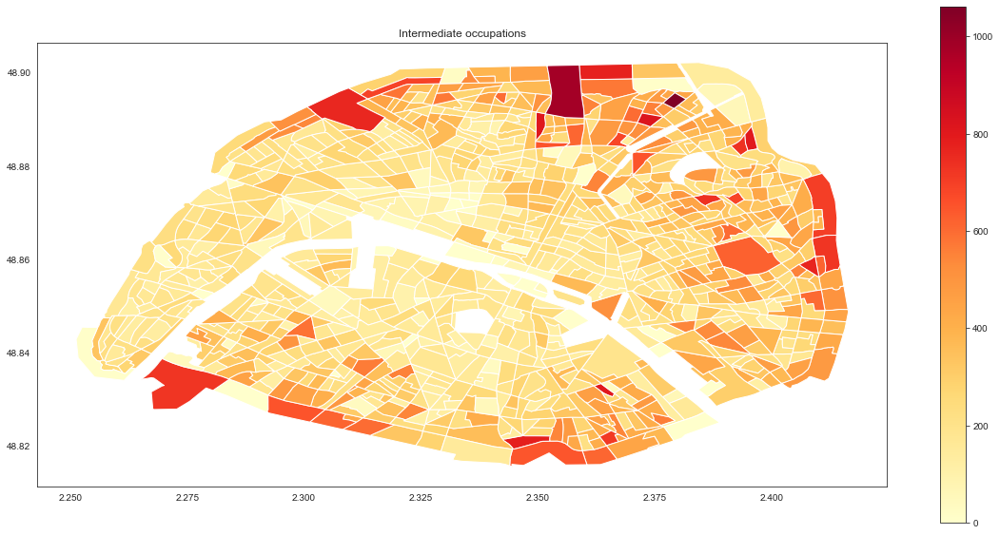

In [26]:
ax = clean_paris.plot(column = 'c12_pop1_4',legend=True,figsize=(20,10),cmap='YlOrRd')
ax.set_title("Intermediate occupations")

## The Foursquare API to explore the Arrondissements of Paris (Neighborhoods)

In [27]:
CLIENT_ID = ' ' # your Foursquare ID
CLIENT_SECRET = ' ' # your Foursquare Secret
radius = 160
LIMIT = 100
VERSION = '20180604'

In [28]:
# Function by coursera
def getNearbyVenues(names, latitudes, longitudes, radius=160):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

Adding latitude and longitude columns into clean_paris dataset

In [29]:
clean_paris['latitudes'] = clean_paris.centroid.y
clean_paris['longitudes'] = clean_paris.centroid.x

Use Foursquare API to get information about some venues around Paris

In [29]:
df_venues = getNearbyVenues(names=clean_paris['Neighborhood'],
                                   latitudes=clean_paris['latitudes'],
                                   longitudes=clean_paris['longitudes']
                                  )

Quinze Vingts 12
Bonne Nouvelle 4
Arts et Metiers 5
Saint-Thomas d'Aquin 8
Folie Mericourt 5
Saint-Ambroise 1
Bel Air 6
Bel Air 9
Picpus 1
Picpus 10
Montparnasse 3
Petit Montrouge 5
Saint-Lambert 10
Grenelle 18
Muette 19
Porte Dauphine 8
Ternes 5
Grandes Carrières 3
Grandes Carrières 22
Clignancourt 6
Chapelle 8
Belleville 11
Saint-Fargeau 14
Charonne 20
Muette 6
Sainte-Marguerite 7
Montparnasse 7
Parc de Montsouris 5
Petit Montrouge 10
Plaisance 14
Plaisance 15
Plaisance 23
Saint-Lambert 32
Necker 1
Grenelle 5
Javel 3
Auteuil 4
Porte Dauphine 6
Chaillot 7
Batignolles 11
Epinettes 11
Grandes Carrières 24
Goutte d'Or 7
Chapelle 7
Amérique 19
Combat 11
Père Lachaise 2
Charonne 24
Gare 6
Gare 27
Les Halles 3
Bonne Nouvelle 5
Saint-Gervais 2
Notre-Dame 2
Notre-Dame 3
EcoLe Militaire 2
Gros Caillou 7
Rochechouart 6
Roquette 8
Roquette 15
Sainte-Marguerite 2
Quinze Vingts 10
Maison Blanche 11
Gros Caillou 5
Champs Elysées 4
Faubourg du Roule 4
Europe 10
Chaussee D'Antin 2
Rochechouart 1
Roch

Europe 9
Chaussee D'Antin 6
Saint-Vincent de Paul 1
Hôpital Saint-Louis 7
Roquette 1
Roquette 4
Roquette 6
Roquette 21
Bel Air 11
Bercy 5
Maison Blanche 20
Maison Blanche 23
Parc de Montsouris 4
Petit Montrouge 4
Plaisance 4
Plaisance 6
Plaisance 9
Plaisance 24
Saint-Lambert 9
Saint-Lambert 22
Saint-Lambert 25
Grenelle 20
Ternes 2
Ternes 8
Plaine Monceau 11
Epinettes 13
Villette 11
Saint-Fargeau 6
Charonne 11
Salpêtrière 4
Gare 18
Gare 20
Gare 23
Place Vendôme 2
Val-de-Grace 3
Notre-Dame des Champs 5
Notre-Dame des Champs 9
Europe 4
Europe 5
Chaussee D'Antin 8
Faubourg Montmartre 2
Hôpital Saint-Louis 8
Folie Mericourt 10
Folie Mericourt 13
Folie Mericourt 14
Saint-Ambroise 9
Bel Air 13
Picpus 5
Croulebarbe 7
Petit Montrouge 12
Saint-Lambert 12
Necker 17
Grenelle 14
Auteuil 23
Auteuil 24
Muette 12
Muette 20
Plaine Monceau 9
Batignolles 7
Clignancourt 10
Villette 5
Amérique 4
Amérique 7
Belleville 14
Saint-Fargeau 10
Saint-Fargeau 15
Charonne 1
Necker 16
Epinettes 17
Clignancourt 4
Gout

In [32]:
df_venues.head(20)

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,0,Quinze Vingts 12,48.843274,2.372482,Hôtel citizenM Paris Gare de Lyon,48.843840,2.371479,Hotel
1,1,Quinze Vingts 12,48.843274,2.372482,Barapapa,48.842121,2.371372,Beer Garden
2,2,Quinze Vingts 12,48.843274,2.372482,CitizenM Rooftop bar,48.843573,2.371193,Hotel Bar
3,3,Quinze Vingts 12,48.843274,2.372482,Café Barge,48.842476,2.370861,Lounge
4,4,Quinze Vingts 12,48.843274,2.372482,EXKi,48.843962,2.372514,Sandwich Place
5,5,Quinze Vingts 12,48.843274,2.372482,Mercure Paris Gare de Lyon,48.844435,2.372945,Hotel
6,6,Quinze Vingts 12,48.843274,2.372482,Paul,48.843815,2.372891,Bakery
7,7,Quinze Vingts 12,48.843274,2.372482,"RER Gare de Lyon [A,D]",48.843607,2.374399,Train Station
8,8,Quinze Vingts 12,48.843274,2.372482,Gamma Cafe,48.844061,2.372439,French Restaurant
9,9,Quinze Vingts 12,48.843274,2.372482,CanteenM,48.843852,2.371852,Breakfast Spot


In [31]:
#df_venues.to_csv("dfvenues160a.csv")


In [31]:
#df_venues = pd.read_csv("dfvenues160a.csv")

### Let's check how many venues were returned for each neighborhood

In [33]:
df_venues.groupby('Neighborhood').count()

,Unnamed: 0,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,,
Amérique 10,1,1,1,1,1,1,1
Amérique 12,2,2,2,2,2,2,2
Amérique 13,1,1,1,1,1,1,1
Amérique 14,5,5,5,5,5,5,5
Amérique 16,2,2,2,2,2,2,2
Amérique 17,2,2,2,2,2,2,2
Amérique 18,2,2,2,2,2,2,2
Amérique 19,5,5,5,5,5,5,5
Amérique 2,4,4,4,4,4,4,4


#### Let's find out how many unique categories can be curated from all the returned venues

In [34]:
print('There are {} uniques categories.'.format(len(df_venues['Venue Category'].unique())))

There are 345 uniques categories.


#### let's write a function to sort the venues in descending order.

In [35]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

#### Create a new dataset contains seafood restaurant

In [36]:
seafood_paris = df_venues[df_venues['Venue Category'].str.contains('Seafood', regex=False)].reset_index(drop = True)

In [37]:
seafood_paris.shape

(54, 8)

In [38]:
seafood_paris.head(6)

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,259,Plaisance 23,48.835816,2.321115,Le Cabanon de l'Écailler,48.836945,2.321144,Seafood Restaurant
1,264,Plaisance 23,48.835816,2.321115,La Cagouille,48.837040,2.321089,Seafood Restaurant
2,267,Plaisance 23,48.835816,2.321115,Vins et Marée,48.836444,2.323069,Seafood Restaurant
3,400,Bonne Nouvelle 5,48.869447,2.349160,La Criée,48.870531,2.348942,Seafood Restaurant
4,421,Saint-Gervais 2,48.858050,2.356556,Les Pinces,48.857552,2.356318,Seafood Restaurant
5,783,Montparnasse 8,48.840804,2.328304,Le Bistrot du Dôme,48.842079,2.329204,Seafood Restaurant


we're looking for uniqueness of venue.

In [39]:
seafood_paris.groupby(['Venue','Venue Latitude', 'Venue Longitude']).size()

Venue                           Venue Latitude  Venue Longitude
Auberge Dab                     48.876717       2.283175           1
Bar à Iode                      48.849600       2.351608           2
Bulot Bulot                     48.883398       2.339614           2
Cabane à Huîtres                48.843106       2.320482           1
Comptoir des Mers               48.854831       2.363115           1
Dessirier                       48.884687       2.296746           1
Fichon                          48.890897       2.345197           2
Homer Lobster                   48.860706       2.354744           1
Huîtrerie Régis                 48.852787       2.335831           1
Huîtres et Saumons de Passy     48.856377       2.279914           1
Juste                           48.874982       2.338510           1
L'Armandie                      48.841693       2.298877           1
L'Huîtrier                      48.879738       2.296134           1
L'Écailler de l'Ebéniste        48.8863

In [40]:
seafood_paris['Venue'].replace('\'',' ', regex=True, inplace=True) 

A seafood restaurant can be between several polygon, we only keep the polygon where it belongs.  

In [41]:
lseafood = seafood_paris['Venue'].unique()
for venue in lseafood:
    seafood_paris.tmp = None
    pol = seafood_paris[seafood_paris['Venue'] == venue]
    list_iris = list(pol['Neighborhood'])
    if (len(pol.groupby("Venue Latitude").count()) ==1):
        vlat = float(pol["Venue Latitude"].unique())
        vlon = float(pol["Venue Longitude"].unique())
        pnt = Point(vlon, vlat)
        for it in list_iris:
            p = clean_paris[clean_paris['Neighborhood']==it]
            if p.contains(pnt).values != True:
                ind = seafood_paris[ (seafood_paris['Venue'] == venue) & (seafood_paris['Neighborhood'] == it)].index
                seafood_paris.drop(ind , inplace=True)
        
seafood_paris.shape

(34, 8)

Verifying the uniqueness

In [42]:
seafood_paris.groupby(['Venue','Venue Latitude', 'Venue Longitude']).size()

Venue                           Venue Latitude  Venue Longitude
Bar à Iode                      48.849600       2.351608           1
Bulot Bulot                     48.883398       2.339614           1
Comptoir des Mers               48.854831       2.363115           1
Dessirier                       48.884687       2.296746           1
Fichon                          48.890897       2.345197           1
Huîtrerie Régis                 48.852787       2.335831           1
Huîtres et Saumons de Passy     48.856377       2.279914           1
L Huîtrier                      48.879738       2.296134           1
L Écailler de l Ebéniste        48.886365       2.317661           1
L Îlot                          48.864666       2.363317           1
La Cagouille                    48.837040       2.321089           1
La Cevicheria Martel            48.874305       2.353257           1
La Criée                        48.870531       2.348942           1
La Mascotte                     48.8856

Loading the fish shop dataset from fishs_paris.csv

In [43]:
fish_paris = pd.read_csv("fishs_paris.csv", sep=';')

In [44]:
fish_paris.head()

,Neighborhood,geom,rate,nb,arr
0,Paris Pêche Poissonnerie,"48.8496521,2.3761939",4.1,80.0,12.0
1,Poissonnerie du Dôme,"48.8553539,2.29108",4.6,35.0,14.0
2,Poissonnerie du Bac,"48.8553593,2.3239106",4.1,26.0,7.0
3,Poissonnerie de Passy,"48.8574656,2.2422722",4.0,5.0,16.0
4,Soguisa,"48.8653066,2.3448942",3.7,34.0,2.0


In [45]:
fish_paris.shape

(59, 5)

In [46]:
lat = []
lon = []

# For each row in a varible,
for row in fish_paris['geom']:
    # Try to,
    try:
        lat.append(row.split(',')[0])
        lon.append(row.split(',')[1])
    except:
        lat.append(np.NaN)
        lon.append(np.NaN)
fish_paris['Latitude'] = lat
fish_paris['Longitude'] = lon

In [47]:
fish_paris.head()

,Neighborhood,geom,rate,nb,arr,Latitude,Longitude
0,Paris Pêche Poissonnerie,"48.8496521,2.3761939",4.1,80.0,12.0,48.8496521,2.3761939
1,Poissonnerie du Dôme,"48.8553539,2.29108",4.6,35.0,14.0,48.8553539,2.29108
2,Poissonnerie du Bac,"48.8553593,2.3239106",4.1,26.0,7.0,48.8553593,2.3239106
3,Poissonnerie de Passy,"48.8574656,2.2422722",4.0,5.0,16.0,48.8574656,2.2422722
4,Soguisa,"48.8653066,2.3448942",3.7,34.0,2.0,48.8653066,2.3448942


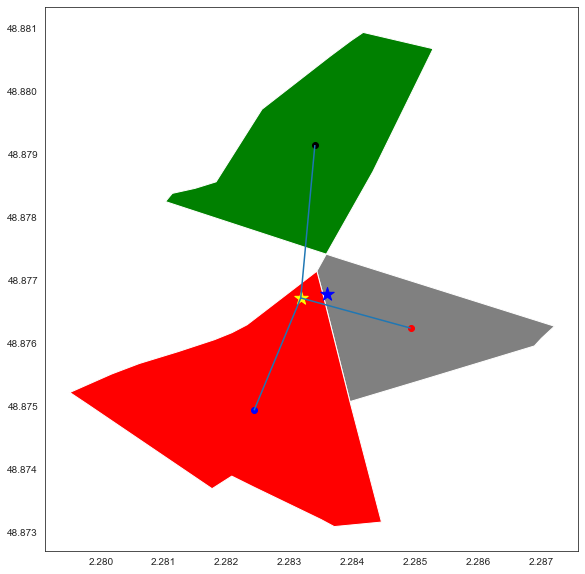

In [48]:

from geopandas import GeoSeries
from shapely.geometry import Point, LineString
# Make a multi-layered plot
fig, ax = plt.subplots(figsize=(10, 10))

p1 = clean_paris[clean_paris['Neighborhood']=="Chaillot 13"]
p1.plot(ax =ax, color='grey')

p1.centroid.plot(ax =ax, color='red')

p2 = clean_paris[clean_paris['Neighborhood']=='Porte Dauphine 11']
p2.plot(ax =ax, color='red')
p2.centroid.plot(ax =ax, color='blue')

p3 = clean_paris[clean_paris['Neighborhood']=='Ternes 16']
p3.plot(ax =ax, color='green')
p3.centroid.plot(ax =ax, color='black')

pA1 = Point(p1.centroid.x, p1.centroid.y)
pA2 = Point(p2.centroid.x, p2.centroid.y)
pA3 = Point(p3.centroid.x, p3.centroid.y)
pA4 = Point(2.283175,48.876717)

gs = GeoSeries(Point(2.283175,48.876717))
gs.plot(ax = ax, marker='*', markersize=200, color='yellow')


line_A = LineString([[pA1.x, pA1.y], [pA4.x, pA4.y]])
line_B = LineString([[pA2.x, pA2.y], [pA4.x, pA4.y]])
line_C = LineString([[pA3.x, pA3.y], [pA4.x, pA4.y]])

gp1 = gpd.GeoDataFrame([['A', pA1, pA4, 16, line_A],['B', pA2, pA4, 16, line_B],['C', pA3, pA4, 16, line_C]],columns=['id', 'beg_pt', 'end_pt', 'value', 'LineString_obj'], 
            geometry='LineString_obj')
gp1.plot(ax = ax)



lat_point_list = [pA1.y, pA2.y, pA3.y]
lon_point_list = [pA1.x, pA2.x, pA3.x]
poly_geom =   Polygon(zip(lon_point_list, lat_point_list))
crs1 = {'init': 'epsg:4326'}
polygon1 = gpd.GeoDataFrame(index=[0],  geometry=[poly_geom])  
# polygon1.plot(ax =ax)
polygon1.centroid.plot(ax=ax,marker='*', markersize=200, color='blue')


Yellow start is venue location and blue start is the gravity center betwen the 3 area, , we only keep the polygon where it belongs.  

Create a temporary dataset

In [49]:
df_temps = clean_paris[['denspop12','Neighborhood','tx12_pop_e', 'tx12_pop_i']]
df_temps.head()

,denspop12,Neighborhood,tx12_pop_e,tx12_pop_i
0,109.405100,Quinze Vingts 12,21.501444,23.802188
1,298.754362,Bonne Nouvelle 4,19.911639,23.935017
2,163.293906,Arts et Metiers 5,19.888973,24.637304
3,2.492091,Saint-Thomas d'Aquin 8,0.000000,0.000000
5,418.708215,Folie Mericourt 5,17.457027,21.617159


Merging clean_paris with seafood_paros on column Neighborhood

In [50]:
df_merge_col = pd.merge(seafood_paris, clean_paris, on='Neighborhood')

In [51]:
df_merge_col.head()

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,objectid,typ_iris,libcom,n_qu,p12_pop_et,p12_pop_im,shape_ha,libiris,iris,denspop12,tx12_pop_e,tx12_pop_i,c12_pop1_1,c12_pop1_2,c12_pop1_3,c12_pop1_4,c12_pop1_5,c12_pop1_6,c12_pop15p,com,geometry,latitudes,longitudes
0,267,Plaisance 23,48.835816,2.321115,Vins et Marée,48.836444,2.323069,Seafood Restaurant,523,H,Paris 14e,56,449.050169,616.450456,8.112891,Plaisance 23,751145623,479.293392,11.548292,15.853352,84.527639,1005.496956,513.072933,554.316017,120.991481,2278.405025,0.0,75114,"POLYGON ((2.32345 48.83623, 2.32375 48.83549, ...",48.835816,2.321115
1,421,Saint-Gervais 2,48.858050,2.356556,Les Pinces,48.857552,2.356318,Seafood Restaurant,126,H,Paris 4e,14,318.129127,413.199572,7.988720,Saint-Gervais 2,751041402,248.894357,15.999675,20.781055,68.800238,620.622404,342.055609,168.188051,46.253913,1245.920215,0.0,75104,"POLYGON ((2.35690 48.86007, 2.35835 48.85902, ...",48.858050,2.356556
2,788,Montparnasse 8,48.840804,2.328304,Le Bar à Huitres,48.841755,2.329892,Seafood Restaurant,474,H,Paris 14e,53,111.022070,188.882087,5.631457,Montparnasse 8,751145308,278.084733,7.089431,12.061264,33.601268,387.139935,269.012012,177.893278,49.269629,916.916122,0.0,75114,"POLYGON ((2.33062 48.83926, 2.32481 48.84119, ...",48.840804,2.328304
3,986,Arts et Metiers 2,48.867246,2.359434,istr,48.867475,2.357595,Seafood Restaurant,103,H,Paris 3e,9,423.845106,500.683951,4.149626,Arts et Metiers 2,751030902,518.673725,19.692641,23.262719,92.559754,830.759803,305.608443,163.040874,90.959192,1482.928066,0.0,75103,"POLYGON ((2.36292 48.86714, 2.36217 48.86685, ...",48.867246,2.359434
4,1094,Porte Saint-Martin 8,48.872242,2.361716,Sur Mer,48.871744,2.362192,Seafood Restaurant,321,H,Paris 10e,39,569.949418,756.676804,6.846195,Porte Saint-Martin 8,751103908,494.693872,16.828697,22.342132,90.002546,958.313395,458.775048,355.923914,196.168639,2059.183544,0.0,75110,"POLYGON ((2.36356 48.87314, 2.36373 48.87291, ...",48.872242,2.361716


# -----------------------------------------------------------------------------------------

### Analyze Each Neighborhood

In [52]:
# one hot encoding
paris_onehot = pd.get_dummies(df_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
paris_onehot['Neighborhood'] = df_merge_col['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [paris_onehot.columns[-1]] + list(paris_onehot.columns[:-1])
paris_onehot = paris_onehot[fixed_columns]

paris_onehot.head()

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Workshop,Auvergne Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basque Restaurant,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Brasserie,Brazilian Restaurant,Breakfast Spot,Breton Restaurant,Brewery,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burgundian Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Castle,Caucasian Restaurant,Cemetery,Ch'ti Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Corsican Restaurant,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dog Run,Doner Restaurant,Donut Shop,EV Charging Station,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,Football Stadium,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Gas Station,Gastropub,Gay Bar,General College & University,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Insurance Office,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Jiangxi Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Knitting Store,Korean Restaurant,Kurdish Restaurant,Laser Tag,Latin American Restaurant,Laundromat,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Lyonese Bouchon,Mac & Cheese Joint,Market,Martial Arts Dojo,Massage Studio,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nature Preserve,New American Restaurant,Newsstand,Night Market,Nightclub,Noodle House,Office,Okonomiyaki Restaurant,Opera House,Optical Shop,Organic Grocery,Outdoor Sculpture,Outlet Store,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Store,Pharmacy,Photography Lab,Piano Bar,Pizza Place,Planetarium,Platform,Playground,Plaza,Poke Place,Pool,Pool Hall,Pop-Up Shop,Portuguese Restaurant,Provençal Restaurant,Pub,Public Art,Radio Station,Ramen Restaurant,Record Shop,Recording Studio,Rental Car Location,Residential Building (Apartment / Condo),Resort,Restaurant,Road,Rock Club,Romanian Restaurant,Roof Deck,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Savoyar

### let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [53]:
paris_grouped = paris_onehot.groupby('Neighborhood').mean().reset_index()
paris_grouped.head()

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Auto Dealership,Auto Workshop,Auvergne Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basque Restaurant,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Brasserie,Brazilian Restaurant,Breakfast Spot,Breton Restaurant,Brewery,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burgundian Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Castle,Caucasian Restaurant,Cemetery,Ch'ti Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Corsican Restaurant,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dog Run,Doner Restaurant,Donut Shop,EV Charging Station,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,Football Stadium,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Gas Station,Gastropub,Gay Bar,General College & University,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Insurance Office,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Jiangxi Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Knitting Store,Korean Restaurant,Kurdish Restaurant,Laser Tag,Latin American Restaurant,Laundromat,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Lyonese Bouchon,Mac & Cheese Joint,Market,Martial Arts Dojo,Massage Studio,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nature Preserve,New American Restaurant,Newsstand,Night Market,Nightclub,Noodle House,Office,Okonomiyaki Restaurant,Opera House,Optical Shop,Organic Grocery,Outdoor Sculpture,Outlet Store,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Store,Pharmacy,Photography Lab,Piano Bar,Pizza Place,Planetarium,Platform,Playground,Plaza,Poke Place,Pool,Pool Hall,Pop-Up Shop,Portuguese Restaurant,Provençal Restaurant,Pub,Public Art,Radio Station,Ramen Restaurant,Record Shop,Recording Studio,Rental Car Location,Residential Building (Apartment / Condo),Resort,Restaurant,Road,Rock Club,Romanian Restaurant,Roof Deck,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Savoyar

In [54]:
paris_grouped.shape

(31, 346)

### let's write a function to sort the venues in descending order.

In [55]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [56]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = paris_grouped['Neighborhood']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head(10)

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Arts et Metiers 2,Lounge,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
1,Auteuil 2,Bakery,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
2,Batignolles 12,French Restaurant,Yoga Studio,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
3,Chaillot 9,Concert Hall,Yoga Studio,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
4,Champs Elysées 3,Art Museum,Yoga Studio,EV Charging Station,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
5,Clignancourt 15,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
6,Clignancourt 3,Mexican Restaurant,Film Studio,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant
7,Combat 14,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
8,Enfants Rouges 1,Asian Restaurant,Yoga Studio,EV Charging Station,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
9,Grandes Carrières 8,Museum,Film Studio,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant


## Cluster Neighborhoods

### let's search the best number of clusters

In [57]:
ks = range(1,10)
inertias = []
paris_grouped_clustering = paris_grouped.drop('Neighborhood', 1)
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters = k)
    
    # Fit model to samples
    model.fit(paris_grouped_clustering)
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)

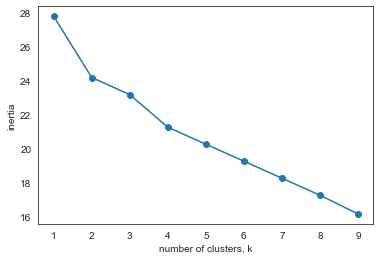

In [58]:
# Plot ks vs inertias
from matplotlib import pyplot as plt
plt.plot(ks, inertias, '-o')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

In [59]:
sil = []
k_sil = range(2,10)
# minimum 2 cluster to define simularity
for k in k_sil:
    print(k, end= ' ')
    kmeans = KMeans(n_clusters = k).fit(paris_grouped_clustering)
    labels = kmeans.labels_
    sil.append(silhouette_score(paris_grouped_clustering, labels, metric = "euclidean"))

2 3 4 5 6 7 8 9 

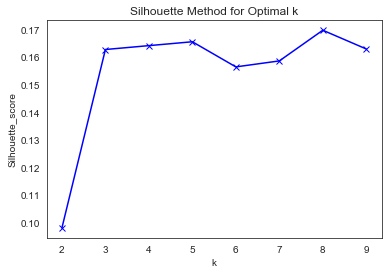

In [60]:
plt.plot(k_sil, sil, 'bx-')
plt.xlabel('k')
plt.ylabel('Silhouette_score')
plt.title('Silhouette Method for Optimal k')
plt.show()

In [61]:
# set number of clusters
kclusters = 5

paris_grouped_clustering = paris_grouped.drop('Neighborhood',1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:20]

array([0, 3, 4, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 2, 0, 0, 1, 0, 0])

In [62]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = seafood_paris
#paris_merged = df_merge_col

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
paris_merged = paris_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

paris_merged.head(10) # check the last columns!

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,267,Plaisance 23,48.835816,2.321115,Vins et Marée,48.836444,2.323069,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
4,421,Saint-Gervais 2,48.858050,2.356556,Les Pinces,48.857552,2.356318,Seafood Restaurant,0,Beer Garden,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
6,788,Montparnasse 8,48.840804,2.328304,Le Bar à Huitres,48.841755,2.329892,Seafood Restaurant,0,Hotel Bar,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
7,986,Arts et Metiers 2,48.867246,2.359434,istr,48.867475,2.357595,Seafood Restaurant,0,Lounge,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
8,1094,Porte Saint-Martin 8,48.872242,2.361716,Sur Mer,48.871744,2.362192,Seafood Restaurant,0,Sandwich Place,Yoga Studio,Donut Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
9,1185,Clignancourt 15,48.891618,2.345747,Fichon,48.890897,2.345197,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
10,1238,Auteuil 2,48.838865,2.264615,Vin et Marée,48.839245,2.264493,Seafood Restaurant,3,Bakery,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
11,1363,Porte Saint-Denis 3,48.871122,2.350587,La Criée,48.870531,2.348942,Seafood Restaurant,0,Train Station,Yoga Studio,EV Charging Station,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
13,1871,Ternes 4,48.878818,2.286766,Léon de Bruxelles,48.878626,2.284652,Seafood Restaurant,4,French Restaurant,Yoga Studio,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
14,2027,Plaine Monceau 13,48.885154,2.295929,Dessirier,48.884687,2.296746,Seafood Restaurant,0,Breakfast Spot,Film Studio,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant


## Final resulting clusters visualization

In [63]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)
kclusters=5
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon,  neig,  cluster in zip(paris_merged['Neighborhood Latitude'], paris_merged['Neighborhood Longitude'], paris_merged['Neighborhood'],  paris_merged['Cluster Labels']):
    label = folium.Popup(' {} - Cluster {}'.format(neig,  cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

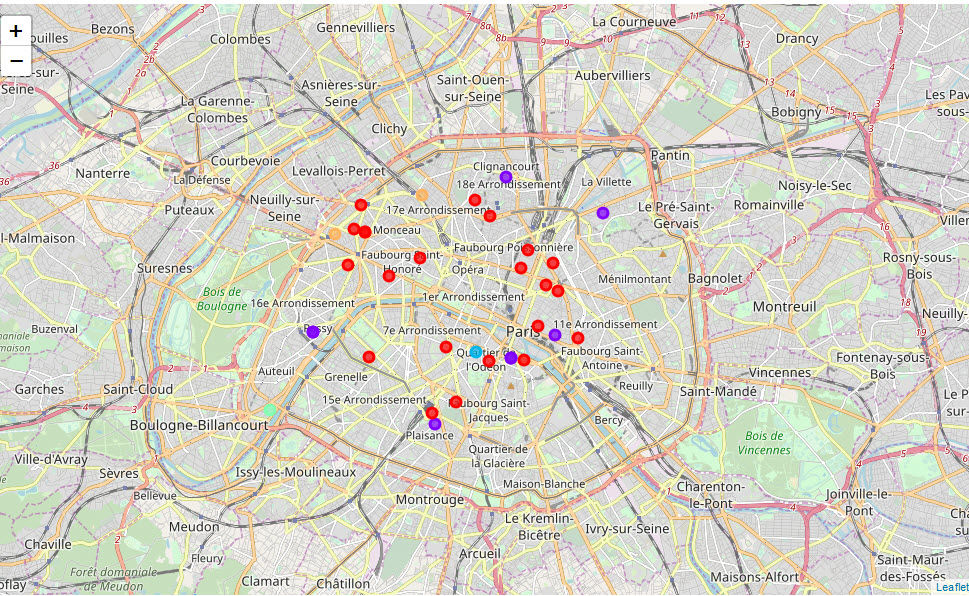

In [64]:
pil_im = Image.open('mb1a.jpg')
display(pil_im)

In [65]:
paris_merged.head()

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,267,Plaisance 23,48.835816,2.321115,Vins et Marée,48.836444,2.323069,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
4,421,Saint-Gervais 2,48.858050,2.356556,Les Pinces,48.857552,2.356318,Seafood Restaurant,0,Beer Garden,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
6,788,Montparnasse 8,48.840804,2.328304,Le Bar à Huitres,48.841755,2.329892,Seafood Restaurant,0,Hotel Bar,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
7,986,Arts et Metiers 2,48.867246,2.359434,istr,48.867475,2.357595,Seafood Restaurant,0,Lounge,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
8,1094,Porte Saint-Martin 8,48.872242,2.361716,Sur Mer,48.871744,2.362192,Seafood Restaurant,0,Sandwich Place,Yoga Studio,Donut Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop


In [66]:
paris_merged.loc[paris_merged['Cluster Labels'] == 0, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]

,Neighborhood,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,Saint-Gervais 2,48.857552,2.356318,Seafood Restaurant,0,Beer Garden,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
6,Montparnasse 8,48.841755,2.329892,Seafood Restaurant,0,Hotel Bar,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
7,Arts et Metiers 2,48.867475,2.357595,Seafood Restaurant,0,Lounge,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market
8,Porte Saint-Martin 8,48.871744,2.362192,Seafood Restaurant,0,Sandwich Place,Yoga Studio,Donut Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
11,Porte Saint-Denis 3,48.870531,2.348942,Seafood Restaurant,0,Train Station,Yoga Studio,EV Charging Station,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
14,Plaine Monceau 13,48.884687,2.296746,Seafood Restaurant,0,Breakfast Spot,Film Studio,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant
16,Ternes 9,48.879409,2.291756,Seafood Restaurant,0,Rental Car Location,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
17,Ternes 10,48.879738,2.296134,Seafood Restaurant,0,Harbor / Marina,Boutique,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
18,Ternes 10,48.878959,2.298816,Seafood Restaurant,0,Harbor / Marina,Boutique,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
19,Porte Saint-Denis 6,48.874305,2.353257,Seafood Restaurant,0,Bar,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market


In [67]:
paris_merged.loc[paris_merged['Cluster Labels'] == 1, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]

,Neighborhood,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,Plaisance 23,48.836444,2.323069,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
9,Clignancourt 15,48.890897,2.345197,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
26,Sorbonne 4,48.850966,2.345896,Seafood Restaurant,1,Bakery,Hotel,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
27,Sorbonne 4,48.850993,2.345795,Seafood Restaurant,1,Bakery,Hotel,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
31,Combat 14,48.884458,2.379391,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop
37,Muette 12,48.856377,2.279914,Seafood Restaurant,1,Hotel,Salad Place,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit
38,Muette 12,48.856218,2.277916,Seafood Restaurant,1,Hotel,Salad Place,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit
41,Saint-Gervais 4,48.854831,2.363115,Seafood Restaurant,1,Hotel,Yoga Studio,Farmers Market,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop


In [68]:
paris_merged.loc[paris_merged['Cluster Labels'] == 2, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
         

,Neighborhood,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
45,Odéon 3,48.852787,2.335831,Seafood Restaurant,2,New American Restaurant,Yoga Studio,Film Studio,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market


In [69]:
paris_merged.loc[paris_merged['Cluster Labels'] == 3, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]

,Neighborhood,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
10,Auteuil 2,48.839245,2.264493,Seafood Restaurant,3,Bakery,Yoga Studio,Fast Food Restaurant,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market


In [70]:
paris_merged.loc[paris_merged['Cluster Labels'] == 4, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]

,Neighborhood,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
13,Ternes 4,48.878626,2.284652,Seafood Restaurant,4,French Restaurant,Yoga Studio,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant
53,Batignolles 12,48.886365,2.317661,Seafood Restaurant,4,French Restaurant,Yoga Studio,Fast Food Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Exhibit,Fabric Shop,Falafel Restaurant


### seafoods restaurant,  Executives and Senior Professional people

### Craftsmen, Traders, Entrepreneurs Population

In [75]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

map_clusters.choropleth(
 geo_data=clean_paris,
 name='choropleth',
 data=clean_paris,
 columns=['Neighborhood', 'c12_pop1_2'],
 key_on='feature.properties.Neighborhood',
 fill_color='YlOrRd',
 fill_opacity=0.8,
 line_opacity=0.2,
 legend_name='Craftsmen, Traders, Entrepreneurs Population'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon,  neig,  cluster in zip(paris_merged['Neighborhood Latitude'], paris_merged['Neighborhood Longitude'], paris_merged['Neighborhood'],  paris_merged['Cluster Labels']):
    label = folium.Popup(' {} - Cluster {}'.format(neig,  cluster), parse_html=True)
    folium.CircleMarker(
                [lat, lon],
                radius=5,
                popup=label,
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)

markers_colors = []
for lat, lon,  neig,  in zip(fish_paris['Latitude'], fish_paris['Longitude'], fish_paris['Neighborhood']):
    label = folium.Popup(' {} '.format(neig), parse_html=True)
    lat = float(lat)
    lon = float(lon)
    folium.CircleMarker(
                [lat, lon],
                radius=10,
                popup=label,
                color='black',
                fill=True,
#                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)

map_clusters

### Executives and Senior Professionals Population

In [74]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

map_clusters.choropleth(
 geo_data=clean_paris,
 name='choropleth',
 data=clean_paris,
 columns=['Neighborhood', 'c12_pop1_3'],
 key_on='feature.properties.Neighborhood',
 fill_color='YlOrRd',
 fill_opacity=0.8,
 line_opacity=0.2,
 legend_name='Executives and Senior Professionals Population'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon,  neig,  cluster in zip(paris_merged['Neighborhood Latitude'], paris_merged['Neighborhood Longitude'], paris_merged['Neighborhood'],  paris_merged['Cluster Labels']):
    label = folium.Popup(' {} - Cluster {}'.format(neig,  cluster), parse_html=True)
    folium.CircleMarker(
                [lat, lon],
                radius=5,
                popup=label,
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)

markers_colors = []
for lat, lon,  neig,  in zip(fish_paris['Latitude'], fish_paris['Longitude'], fish_paris['Neighborhood']):
    label = folium.Popup(' {} '.format(neig), parse_html=True)
    lat = float(lat)
    lon = float(lon)
    folium.CircleMarker(
                [lat, lon],
                radius=10,
                popup=label,
                color='black',
                fill=True,
#                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)
map_clusters

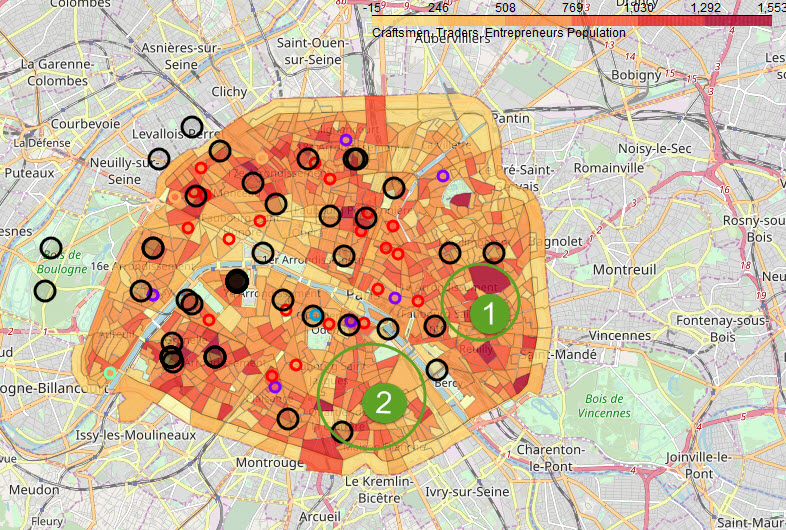

In [77]:
pil_im = Image.open('mb3a.jpg')
display(pil_im)

###  Intermediate occupations

In [78]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

map_clusters.choropleth(
 geo_data=clean_paris,
 name='choropleth',
 data=clean_paris,
 columns=['Neighborhood', 'c12_pop1_4'],
 key_on='feature.properties.Neighborhood',
 fill_color='YlOrRd',
 fill_opacity=0.8,
 line_opacity=0.2,
 legend_name='Intermediate occupations Population'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon,  neig,  cluster in zip(paris_merged['Neighborhood Latitude'], paris_merged['Neighborhood Longitude'], paris_merged['Neighborhood'],  paris_merged['Cluster Labels']):
    label = folium.Popup(' {} - Cluster {}'.format(neig,  cluster), parse_html=True)
    folium.CircleMarker(
                [lat, lon],
                radius=5,
                popup=label,
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)

markers_colors = []
for lat, lon,  neig,  in zip(fish_paris['Latitude'], fish_paris['Longitude'], fish_paris['Neighborhood']):
    label = folium.Popup(' {} '.format(neig), parse_html=True)
    lat = float(lat)
    lon = float(lon)
    folium.CircleMarker(
                [lat, lon],
                radius=12,
                popup=label,
                color='black',
                fill=True,
#                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)
map_clusters

### Immigrant

In [ ]:
Seafood near immigrant population

In [79]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

map_clusters.choropleth(
 geo_data=clean_paris,
 name='choropleth',
 data=clean_paris,
 columns=['Neighborhood', 'p12_pop_im'],
 key_on='feature.properties.Neighborhood',
 fill_color='YlOrRd',
 fill_opacity=0.8,
 line_opacity=0.2,
 legend_name='immigrant population'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon,  neig,  cluster in zip(paris_merged['Neighborhood Latitude'], paris_merged['Neighborhood Longitude'], paris_merged['Neighborhood'],  paris_merged['Cluster Labels']):
    label = folium.Popup(' {} - Cluster {}'.format(neig,  cluster), parse_html=True)
    folium.CircleMarker(
                [lat, lon],
                radius=5,
                popup=label,
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)

markers_colors = []
for lat, lon,  neig,  in zip(fish_paris['Latitude'], fish_paris['Longitude'], fish_paris['Neighborhood']):
    label = folium.Popup(' {} '.format(neig), parse_html=True)
    lat = float(lat)
    lon = float(lon)
    folium.CircleMarker(
                [lat, lon],
                radius=10,
                popup=label,
                color='black',
                fill=True,
#                fill_color=rainbow[cluster-1],
                fill_opacity=0.1).add_to(map_clusters)
map_clusters

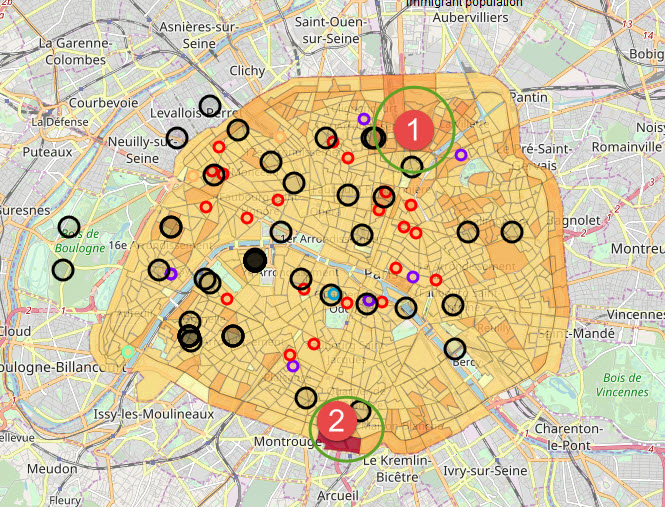

In [80]:
pil_im = Image.open('mb4a.jpg')
display(pil_im)

## Result

Cluster 0: It is the largest cluster where you can find all the people who work in Paris.

Cluster 1: it's mostly travellers who go to hotels...

Cluster 2: it's the people who love shows, there's the odeon theatre and film studios.

Cluster 3: less urbanized, people who escape from the center of Paris.

Cluster 4: people who like to go for a walk in Paris.


## Conclusion

The best locations are often already taken or extremely difficult to obtain. The amount of the lease fee can quickly skyrocket. 

In this project I use the demographic trends in the neighbourhood and the characteristics of the individuals frequenting the neighbourhood (residents, transients, employees, workers...).

we can use others criteria for choosing a good commercial location.

The flow of passers-by (or cars).  
Ease of access  
The attractiveness of the business environment.  
Visibility  
The exhibition.  
Future urban developments  
